# In the name of God
# Machine Learning for Bioinformatics (Spring 1400)
# HW4 - CNN

# Student Info

## Full Name: (AmirHossein Mohammadi)

## Student Number: (99201081)

## Don't forget to change this file name to HW4_{student number}.ipynb


In [18]:
########################## P0 ##########################
# README                                               #
########################################################
# You must fill the parts like this that surrounded by comments
########################## END #########################

# Imports

In [19]:
RUN_LOCAL = True  # if you want to run this on colab, set this to False

In [20]:
# https://github.com/jacobgil/pytorch-grad-cam
if not RUN_LOCAL:
    !pip install grad-cam

<div dir="rtl">
اضافه کردن کتابخانه های مورد نیاز برای این تمرین
</dir>

In [21]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms 
from torch.utils.data import DataLoader
from tqdm.auto import tqdm
if not RUN_LOCAL:
    from google.colab import drive
from IPython import display
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from pytorch_grad_cam import GradCAMPlusPlus
from pytorch_grad_cam.utils.image import show_cam_on_image,preprocess_image

# Configs

In [22]:
%matplotlib inline

<div dir="rtl">
تنظمیات اولیه برخی از پارامترها، این پارامترها در بخش های بعدی مورد استفاده قرار می گیرند.
</dir>

In [23]:
BATCH_SIZE = 32
DATA_LOADER_KWARGS = {
    'batch_size': BATCH_SIZE, 
    'shuffle': True,
    'pin_memory': True,
    'num_workers': 0,
}

RGB_MEANS = [0.485, 0.456, 0.406]
RGB_STD = [0.229, 0.224, 0.225]

<div dir="rtl">
برای اجرای کدها های موحود در این تمرین باید از بین دو گزینه سی پی یو و جی پی یو یکی را انتخاب کنیم که به خاطر اینکه جی پی یو سیستم بنده امکان استفاده را نداشت روی cpu تنظیم شد. البه مراحل تا حدی طولانی تر شد اما به خاطر اینکه کولب مشکلات بیشتری مثل اینترآپت و مسئله آپلود نیم گیگ وزن های آموزش دیده رو داشت  دیگه روی سی پی یو تست ها انجام شد. 
</dir>

In [24]:
DEVICE =None
########################## P1 ##########################
# check if gpu is available then put DEVICE to cuda:0  #
# else DEVICE is equal to cpu.                         #
########################################################
if torch.cuda.is_available():
     DEVICE=cuda0 = torch.device('cuda:0')
else:
    DEVICE=cuda0 = torch.device('cpu')
########################## END #########################
DEVICE

device(type='cpu')

# Data

## Load from Google Drive (if you want to run code on colab)

First create a folder named "ML for Bio - Spring 1400" in your google drive root and copy the content of [this link](https://drive.google.com/drive/folders/1X53xvmmS3avr6py7Cf1LUq8DSA1EvNpC?usp=sharing) to it.

Make sure you do this correctly and the next cell runs with no error.

In [9]:
if not RUN_LOCAL:
    # Load data from google drive
    drive.mount('/content/drive', force_remount=True)

    # Don't change this, you must put the data here in your Google Drive
    FOLDERNAME = 'ML\ for\ Bio\ -\ Spring\ 1400/brain-tumor-dataset'

    %cd drive/My\ Drive
    %cp -r $FOLDERNAME ../../
    %cd ../../brain-tumor-dataset
    !unzip -q dataset.zip
    !rm dataset.zip
    %cd ..

## Local Data

If you want to run the code locally, download the [dataset.zip](https://drive.google.com/file/d/158VyFbTPLHE_uN2yXvMtalSqdD2mdd5r/view?usp=sharing) and extract it in 'brain-tumor-dataset' folder besides your code. it must has a structure like below:

```
HW4_{student number}.ipynb
brain-tumor-dataset/
    no/
    yes/
```

## Create DataLoaders

<div dir="rtl">
ایجاد یک ترنسفورمر با توجه به خواسته ها ی مطرح شده در فایل تمرین، همچنین استفاده از متغیر های RGB_MEANS و RGB_STD که در سلول های بالایی تعریف شده بود برای نرمال کردن داده ها 
</dir>

In [10]:
transforms = []
########################## P2 ##########################
# Create a list of torchvision.transforms to:          #
# 1- Resize the image to 256x265 pixels                #
# 2- Center Crop the image to 224x224 pixels           #
# 3- Convert To Tensor                                 #
# 4- Normalize the tensor with RGB_MEANS and RGB_STD   #
########################################################
transforms.append(torchvision.transforms.Resize(256))
transforms.append(torchvision.transforms.CenterCrop(224))
transforms.append(torchvision.transforms.ToTensor())
transforms.append(torchvision.transforms.Normalize(
       mean=RGB_MEANS,
       std=RGB_STD))
########################## END #########################
transforms = torchvision.transforms.Compose(transforms)

transforms

Compose(
    Resize(size=256, interpolation=bilinear, max_size=None, antialias=None)
    CenterCrop(size=(224, 224))
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)

<div dir="rtl">
خواندن داده های مورد نیاز برای انی ترمین از مسیر ایجاد شده و همچنین تقسیم آنها به سه قمست train,test,validation برای این منظور ابتدا داده ها به دو قسمت 2100 و 900 تایی که اولی برای داده های train است و دومی 30 درصد داده هاست که به دو بخش testوvalidation تقسیم می کنیم. سپس با استفاده از dataloader و مقادیری که در سلول های بالایی تنظیم کردیم داده هارا لود می کنیم. 
</dir>

In [11]:
train_dataset, val_dataset, test_dataset = None, None, None
all_dataset = torchvision.datasets.ImageFolder('brain-tumor-datase/', transform=transforms)
########################## P3 ##########################
# First split the all_dataset into three datasets with:#
# 70% Train, 20% Validation, 10% Test.                 #
# There is a function in torch.utils for this purpose. #
########################################################
train_dataset, val_dataset = torch.utils.data.random_split(all_dataset,[2100, 900])
val_dataset, test_dataset = torch.utils.data.random_split(val_dataset, [600, 300])
########################## END #########################
train_loader = DataLoader(train_dataset, **DATA_LOADER_KWARGS)
val_loader = DataLoader(val_dataset, **DATA_LOADER_KWARGS)
test_loader = DataLoader(test_dataset, **DATA_LOADER_KWARGS)

print('Train Classes Dist:', np.bincount(np.array(all_dataset.targets)[train_dataset.indices]))
print('Val Classes Dist:  ', np.bincount(np.array(all_dataset.targets)[val_dataset.indices]))
print('Test Classes Dist: ', np.bincount(np.array(all_dataset.targets)[test_dataset.indices]))


FileNotFoundError: [WinError 3] The system cannot find the path specified: 'brain-tumor-datase/'

<div dir="rtl">
نمایش ابعاد داده ها و تعداد کلاس های این دیتا ست 
</dir>

In [11]:
input_shape = tuple(all_dataset[0][0].shape)
num_classes = len(all_dataset.classes)

print('Input Shape =', input_shape)
print('Num of Classes =', num_classes)

Input Shape = (3, 224, 224)
Num of Classes = 2


## Visualizing

In [12]:
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, tensor):
        """
        Args:
            tensor (Tensor): Tensor normalized image of size (C, H, W).
        Returns:
            Tensor: UnNormalized image.
        """
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
        return tensor

unnormalize = UnNormalize(RGB_MEANS, RGB_STD)

<div dir="rtl">
نمایش داده ها  
</dir>

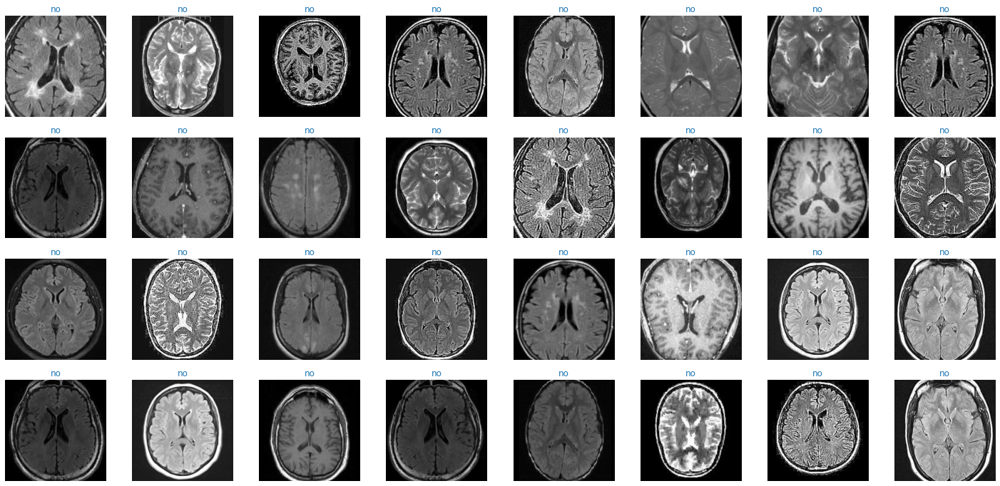

In [13]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(test_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)

fig = plt.figure(figsize=(25, 12))
gs = fig.add_gridspec(int(np.ceil(vis_num_images / vis_images_per_row)), vis_images_per_row)

for i in range(vis_num_images):
    ax = fig.add_subplot(gs[i // vis_images_per_row, i % vis_images_per_row])
    ax.set_title(f'{all_dataset.classes[vis_labels[i]]}', c=f'C{vis_labels[i]}')
    ax.axis('off')
    ax.imshow(vis_images[i])

plt.show()

# Train & Test Methods

## Train

In [14]:
def train(model, train_loader, val_loader, optimizer, num_epochs=10):
    train_log = []
    test_log = []
    plt.figure(figsize=(16, 8))

    for epoch in range(1, num_epochs+1):
        train_loss = []
        model.train()
        for inputs, targets in tqdm(train_loader, desc='Training epoch ' + str(epoch), leave=False):        
            inputs, targets = inputs.to(DEVICE), targets.to(DEVICE)        
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = model.get_loss(outputs, targets)
            loss.backward()
            optimizer.step()
            train_loss.append(loss.item())
        train_log.append(np.mean(train_loss))

        test_loss = []
        model.eval()
        with torch.no_grad():                
            for inputs, targets in tqdm(test_loader, desc='Validation', leave=False):         
                inputs, targets = inputs.to(DEVICE), targets.to(DEVICE)
                outputs = model(inputs)
                loss = model.get_loss(outputs, targets)
                test_loss.append(loss.item())
        test_log.append(np.mean(test_loss))

        plt.clf()
        plt.title(f'Epoch {epoch}/{num_epochs}')
        plt.plot(range(1, epoch+1), train_log, color='C0', label='Train')
        plt.plot(range(1, epoch+1), test_log, color='C1', label='Val')
        plt.legend()
        display.clear_output(wait=True)
        display.display(plt.gcf())

    plt.close()

## Test

In [15]:
def test(model, data_loader):
    y_true, y_pred = [], []

    with torch.no_grad():                
        for inputs, targets in tqdm(data_loader, desc='Predicting', leave=False):         
            inputs, targets = inputs.to(DEVICE), targets.to(DEVICE)
            outputs = model(inputs)
            if type(outputs) is tuple: outputs = outputs[-1]
            outputs = outputs.detach().cpu().numpy()

            y_true += targets.detach().cpu().numpy().tolist()
            y_pred += np.argmax(outputs, axis=-1).tolist()

    print(classification_report(y_true, y_pred, target_names=all_dataset.classes))

# Model Definition

<div dir="rtl">
 در این قسمت ابتدا وزن های از پیش اموزش داده شده vgg16  را با استفاده از بتچ نرمالیزشین را دانلود می کینم و پس از تعریف مدل vgg16 آنرا لود می کنیم برای حالت یادگیری انتقالی. همچنین با توجه به خواسته های مسئله برای حالتی که خودمان باید یک شبکه ایجاد کنیم  با توجه به شرایط مسئله یک شبکه کانوولوشنی طراحی می کنیم  با استفاده از یک حلقه مقادیری که در لیست convs قرار دارد را به شبکه اضافه می کنیم. همچنین تعداد کانال های شبکه کانوولوشنی را در ابتدا 3 قرار  می دهیم. همچنین برای لایه ی فولی کانکتد که برای هر دو حالت شبکه vgg16 و شبکه طراحی شده توسط خودمان با توجه به خواسته مسئله شرایط را رعایت می کنیم لایه ی اول. بعد از faltten ورودی لایه فولی کانکتد را حاضل ضرب لایه ی خروجی لایه کانوولوشنی قرار می دهیم. در این جا نیز چون ممکن است لایه های فولی کانکتد چنیدن لایه باشد یهک حلقه تعریف می کنیم که لایه های فولی کانکتد را وارد می کند. پس اجرای حلقه نیز با توجه خواسته مسئله آخرین لایه فولی کانکتد که خروجی برابر با تعداد کلاس های مسئله ما دارد تنظیم می کنیم.  
</dir>

In [1]:
class ConvClassifier(nn.Module):
    def __init__(self, input_shape, num_classes, convs, fcs, conv_drop_rate=None, fc_drop_rate=None):
        """
        Args:
            input_shape: the dimension of the input image.
            num_classes: number of output classes.
            convs: it's 'vgg16' or a list of tuples with these info\:
                (out_channels, kernel_size, stride, padding, has_pooling), the first four are
                the configuration for creating a Conv2d layer and if has_pooling was True, you
                must add a MaxPool2d after the Conv2d.
            fcs: a list of integers representing number of Linear neurons in each layer
            conv_drop_rate: float(0-1), drop rate used for Conv2d layers
            fc_drop_rate: float(0-1), drop rate used for Linear layers
        """
        super(ConvClassifier, self).__init__()

        # Convolution Layers
        self.conv_layers = None
        if convs == 'vgg16':
            vgg16_pretrained = None
            ########################## P4 ##########################
            # set `vgg16_pretrained` to pretrained vgg16 model with#
            # batch normalization                                  #
            ########################################################
            vgg16_pretrained = torchvision.models.vgg16_bn() 
            vgg16_pretrained.load_state_dict(torch.load("vgg16_bn-6c64b313.pth"))
            ########################## END #########################
            self.conv_layers = vgg16_pretrained.features
        elif type(convs) is list:
            conv_layers = []
            vgg16_pretrained = torchvision.models.vgg16_bn() 
            ########################## P5 ##########################
            # for each item in `convs` add these 3-5 items to      #
            # `conv_layers`:                                       #
            # 1- nn.Conv2d                                         #
            # 2- nn.BatchNorm2d                                    #
            # 3- nn.ReLU                                           #
            # 4- nn.Dropout if `conv_drop_rate` is not None        #
            # 5- nn.MaxPool2d(2, 2) if has_pooling is True         #
            ########################################################
            conv_layers.append(nn.Conv2d(3, convs[0][0],kernel_size=convs[0][1], stride=convs[0][2], padding=convs[0][3]))
            conv_layers.append(nn.BatchNorm2d(convs[0][0]))
            conv_layers.append(nn.ReLU())
            if conv_drop_rate!=None:
                conv_layers.append(nn.Dropout(conv_drop_rate))
            if convs[0][4]==True:
                conv_layers.append(nn.MaxPool2d(2, 2))
            for i in range(1,len(convs)):
                conv_layers.append(nn.Conv2d(convs[i-1][0], convs[i][0],kernel_size=convs[i][1], stride=convs[i][2], padding=convs[i][3]))
                conv_layers.append(nn.BatchNorm2d(convs[i][0]))
                conv_layers.append(nn.ReLU())
                if conv_drop_rate!=None:
                    conv_layers.append(nn.Dropout(conv_drop_rate))
                if convs[i][4]==True:
                    conv_layers.append(nn.MaxPool2d(2, 2))
                
            ########################## END #########################
            self.conv_layers = nn.Sequential(*conv_layers)
        else:
            raise Exception(f'Wrong value for parameter `convs`: {convs}')
        # Get the output shape of last conv layer
        convs_output_shape = self.conv_layers(torch.randn(1, *input_shape)).shape[1:]

        # Fully Connected Layers
        fc_layers = []
        ########################## P6 ##########################
        # first add a nn.Flatten to `fc_layers` then for each  #
        # value in `fcs` add these 3-4 items to `fc_layers`:   #
        # 1- nn.Linear                                         #
        # 2- nn.BatchNorm1d                                    #
        # 3- nn.ReLU                                           #
        # 4- nn.Dropout if `fc_drop_rate` is not None          #
        # in the end add a nn.Linear for the final output with #
        # `num_classes` neurons and a nn.Softmax after it.     #
        ########################################################
        fc_layers.append(nn.Flatten())
        fc_layers.append(nn.Linear(convs_output_shape[0]*convs_output_shape[1]*convs_output_shape[2],fcs[0]))
        fc_layers.append(nn.BatchNorm1d(fcs[0]))
        fc_layers.append(nn.ReLU())
        if fc_drop_rate!=None:
            fc_layers.append(nn.Dropout(fc_drop_rate))
        for i in range(1,len(fcs)):
            fc_layers.append(nn.Linear(fcs[i-1],fcs[i]))
            fc_layers.append(nn.BatchNorm1d(fcs[i]))
            fc_layers.append(nn.ReLU())
            if fc_drop_rate!=None:
                fc_layers.append(nn.Dropout(fc_drop_rate))
        fc_layers.append(nn.Linear(fcs[len(fcs)-1],num_classes))  
        fc_layers.append(nn.Softmax())
        ########################## END #########################
        self.fc_layers = nn.Sequential(*fc_layers)
        self.cross_entropy = nn.CrossEntropyLoss()

    def forward(self, x):
        output = None
        ########################## P7 ##########################
        # generate the output using created variables.         #
        ########################################################
        output1=self.conv_layers(x)
        output=self.fc_layers(output1)
        
        ########################## END #########################
        return output

    def get_loss(self, outputs, targets):
        loss = None
        ########################## P8 ##########################
        # calculate the loss using `self.cross_entropy`        #
        ########################################################
        loss=self.cross_entropy(outputs,targets)
        ########################## END #########################
        return loss

NameError: name 'nn' is not defined

# Vanilla VGG16 (no pretrain)

## Create Model

<div dir="rtl">
    مقداردهی های اولیه برای ایحاد یک شبکه با سه لایه ی کانوولوشنی
</dir>

In [17]:
vgg16 = None
convs=[(64,3,1,1,True),(128,3,1,1,True),(256,3,1,1,True)]
fcs=[10,8,5]

########################## P9 ##########################
# By using the `ConvClassifier` class create vgg16.    #
# in this part you must write the layers specifications#
# yourself (use convs = list of tuples).               #
# Change the drop rates to get best result in 10 epochs#
########################################################
vgg16=ConvClassifier(input_shape=input_shape,num_classes=num_classes,convs=convs,fcs=fcs,conv_drop_rate=0.1,fc_drop_rate=0.1)
########################## END #########################

vgg16.to(DEVICE)
vgg16

C:\Users\asus\anaconda3\lib\site-packages\torch\nn\functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  ..\c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


ConvClassifier(
  (conv_layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU()
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (fc_layers): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=200704, out_features=10, bias=True)
    (2): BatchNorm1d

## Train

In [21]:
optimizer = torch.optim.Adam(vgg16.parameters(), lr=1e-3)

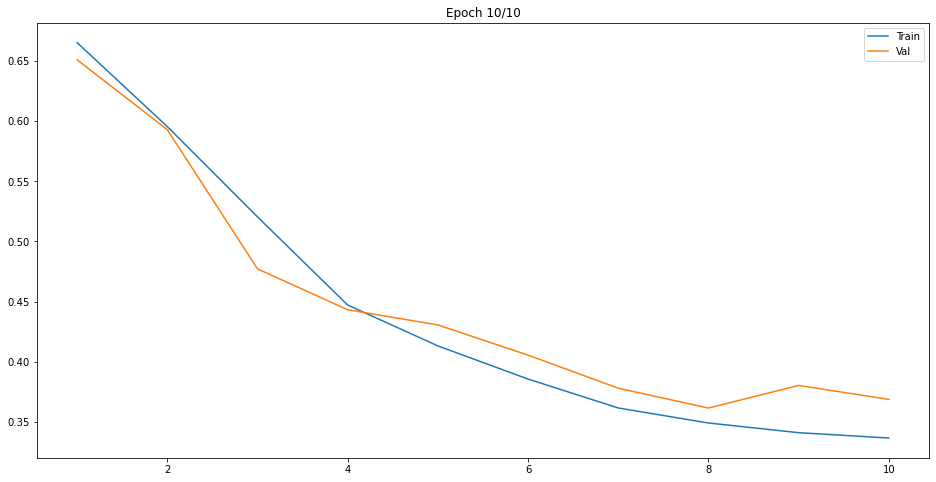

In [22]:
train(vgg16, train_loader, val_loader, optimizer, num_epochs=10)

## Test

In [23]:
test(vgg16, train_loader)

              precision    recall  f1-score   support

          no       1.00      1.00      1.00      1041
         yes       1.00      1.00      1.00      1059

    accuracy                           1.00      2100
   macro avg       1.00      1.00      1.00      2100
weighted avg       1.00      1.00      1.00      2100



In [24]:
test(vgg16, val_loader)

              precision    recall  f1-score   support

          no       0.98      0.94      0.96       307
         yes       0.94      0.98      0.96       293

    accuracy                           0.96       600
   macro avg       0.96      0.96      0.96       600
weighted avg       0.96      0.96      0.96       600



In [25]:
test(vgg16, test_loader)

              precision    recall  f1-score   support

          no       0.95      0.96      0.96       152
         yes       0.96      0.95      0.96       148

    accuracy                           0.96       300
   macro avg       0.96      0.96      0.96       300
weighted avg       0.96      0.96      0.96       300



## CAM (Class Activation Map)

<div dir="rtl">
ایحاد یک تابع برای gard cam کردن تصاویر، با توجه به خساته تمرین ابتدا تصاویر اصلی را نمایش می دهیم و سپس تصاویر gradcam را. برای این منظور به تابع gradcamplusplus مدل آموزش دیده و لیبل ها را پاس می دهیم. همچینین برای ماسکر کردن قسمت های از تصویر که تومور نیست از بخش هایی که تومور هست از یک تابع استفاده می کنیم به نام preprocess_image که در بخش کتابخانه ها همراه show cam on image اضافه کرده ایم. و با استفاده از تابع show cam on image نتایج را برای نمایش در خروجی آماده می کنیم. 
</dir>

In [28]:
def CAM(model, target_layer):
    fig = plt.figure(figsize=(25, 12))
    gs = fig.add_gridspec(int(np.ceil(vis_num_images / vis_images_per_row)), vis_images_per_row)
    ########################## P10 #########################
    # Create the same grid of images as "Visualizing" part #
    # but you must add G_CAM overlay to them too. use        #
    # `GradG_CAMPlusPlus` and `show_G_CAM_on_image` for this.  #
    ########################################################
    for i in range(vis_num_images):
        ax = fig.add_subplot(gs[i // vis_images_per_row, i % vis_images_per_row])
        ax.set_title(f'{all_dataset.classes[vis_labels[i]]}', c=f'C{vis_labels[i]}')
        ax.axis('off')
        ax.imshow(vis_images[i])
    ###################################################################
    fig1 = plt.figure(figsize=(25, 12))
    gs_CA = fig.add_gridspec(int(np.ceil(vis_num_images / vis_images_per_row)), vis_images_per_row)
    for i in range(vis_num_images):
        ax = fig1.add_subplot(gs_CA[i // vis_images_per_row, i % vis_images_per_row])
        ax.set_title(f'{all_dataset.classes[vis_labels[i]]}', c=f'C{vis_labels[i]}')
        ax.axis('off')
        G_CAM = GradCAMPlusPlus(model=model, target_layer=target_layer)
        back_G_CAM = G_CAM(input_tensor=preprocess_image(vis_images[i],mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]))
        back_G_CAM = back_G_CAM[0, :]
        output = show_cam_on_image(vis_images[i],mask=back_G_CAM)
        ax.imshow(output)
    
    
    

    plt.show()

C:\Users\asus\anaconda3\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


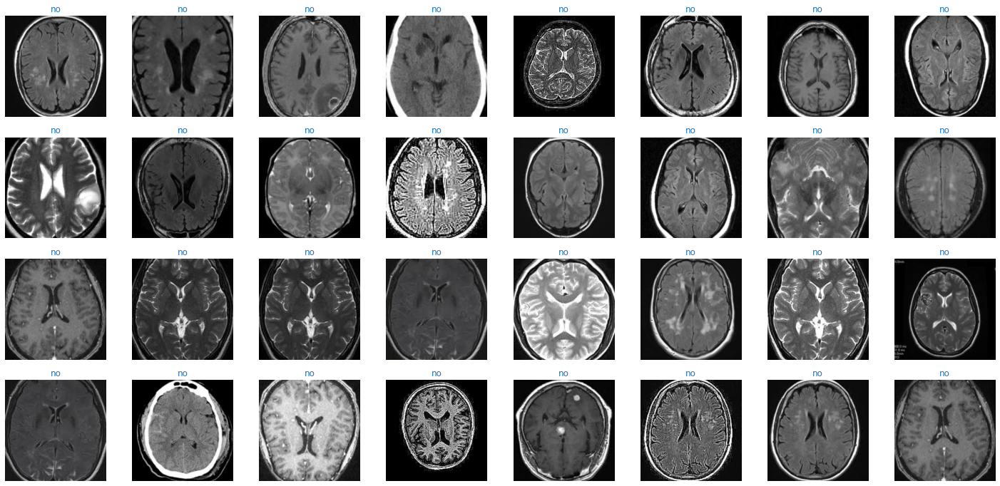

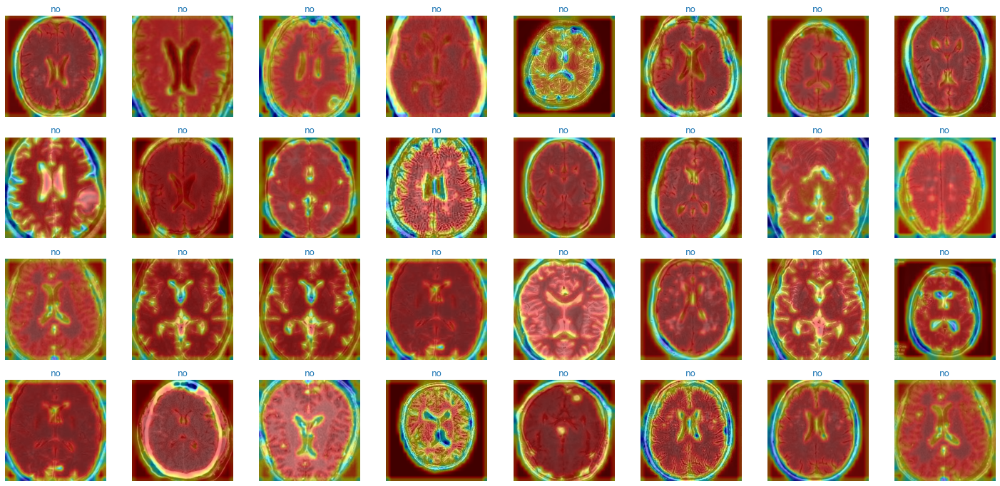

In [33]:
CAM(vgg16, vgg16.conv_layers[-1])

<div dir="rtl">
   با توجه به اینکه داده های تست تعداد کمتری نسبت به داده های آموزشی دارند برای همین ممکن است هنگام استفاده از Gradcam داده ای با لیبل no صرفا انتخاب شوند همانطور که در بالا مشاهده می کنید به همین علت برای دید بهتر و درک بهتر نتایج Gard Cam از یکبار هم از مجموعه دادگان آموزشی استفاده می کنیم که تا احتمال حضور دادگان با لیبل yes نیز افزایش یابد و بتوانیم نتایج را بهتر مشاهده کنیم 
</dir>

In [34]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(train_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


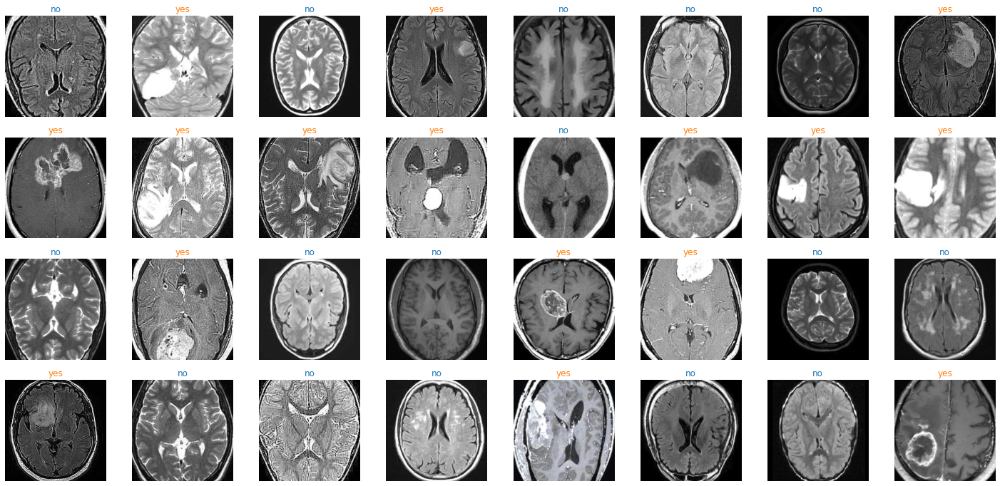

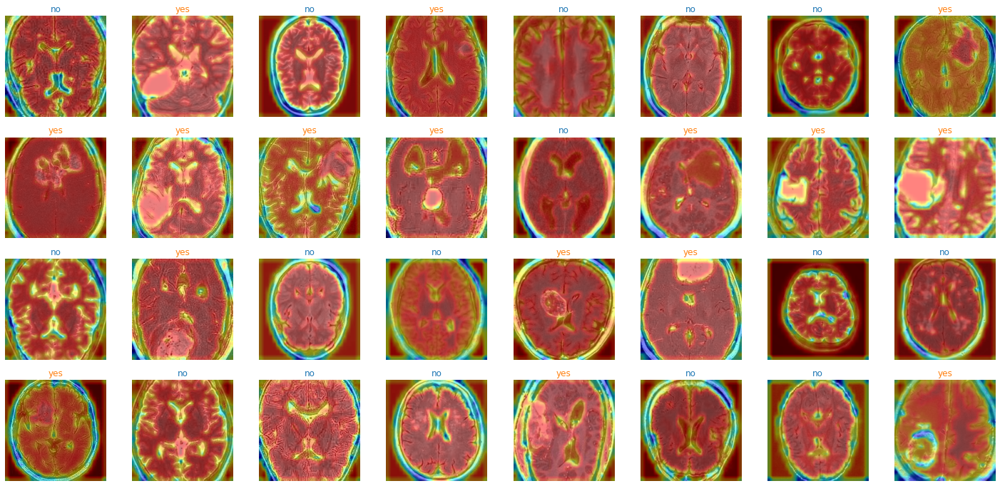

In [35]:
CAM(vgg16, vgg16.conv_layers[-1])

# Transfer Learning

## Create Model

In [18]:
vgg16_imagenet = None
########################## P11 #########################
# Like "P9" but use convs = 'vgg16' this time.           #
########################################################
########################## END #########################
convs='vgg16'
fcs=[10,8,5]
########################################################
vgg16_imagenet=ConvClassifier(input_shape=input_shape,num_classes=num_classes,convs=convs,fcs=fcs,conv_drop_rate=0.1,fc_drop_rate=0.1)
########################## END #########################

vgg16_imagenet.to(DEVICE)
vgg16_imagenet

ConvClassifier(
  (conv_layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): C

## Train

In [37]:
########################## P12 #########################
# Change the Learning Rate and compare the results.    #
# write your observation and its reasons in the next   #
# cell.                                                #
########################################################
optimizer = torch.optim.Adam(vgg16_imagenet.parameters(), lr=1e-3)
########################## END #########################

<div dir="rtl">
  همانوطر که در ادامه مشاهده می کنید در این تمرین از سه مقدار برای پارمتر نرخ یادگیری استفاده شده است که به ترتیب این مقدارها برابر 0.01،0.001،0.0001 هستند. هماطور که مشاهده می شود هنگامی که مقدار نرخ یادگیری از 0.001 به 0.01 کاهش پیدا کرد نتایج تحت تاثیر قرار گفت و دچار افت دقت شد این مسئله را می توان اینگونه تفسیر کرد که هنگامی که نرخ یادگیری کاهش می یابد ما از نقطه ی مینیمم و بهینه رد میشویم (به جای همگرایی، واگرا می شویم) و این مسئله به خاطر این است که با شدت بییشتری به روز رسانی ها را انجام می دهیم و این مسئله به خاطر افزایش نرخ یادگیری بوده است  بنابراین در 10 epoch مقدار loss به اندازه نرخ  یادگیری 0.001 کاهش نمی یابد. زمانی که نرخ یادگیری را 0.0001 قرار دادیم نتایج بهبود یافت به طوریکه دقت بر روی دادگان تست و ولیدیشن به 0.99 افزایش یافت. این مسئله را می توان اینگونه تفسیر کرد که به علت کنترل بهتر نرخ یادگیری  به روز رسانی های ما همواره در راستای نقاط بهینه و همگرایی پیش می رویم و از واگرایی و رد کردن نقاط بهینه جلوگیری می کنیم.  
</dir>

P12 Answer:


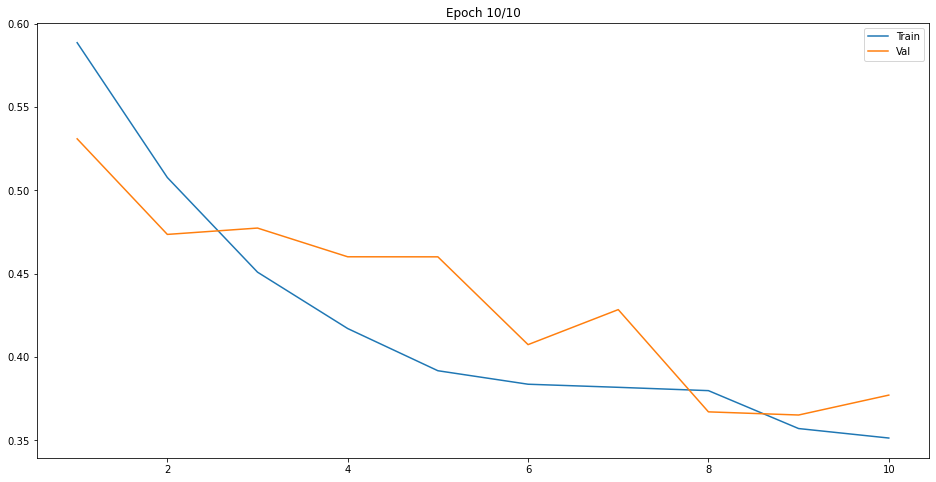

In [40]:
train(vgg16_imagenet, train_loader, val_loader, optimizer, num_epochs=10)

## Test

In [41]:
test(vgg16_imagenet, train_loader)

              precision    recall  f1-score   support

          no       0.99      0.96      0.98      1041
         yes       0.97      0.99      0.98      1059

    accuracy                           0.98      2100
   macro avg       0.98      0.98      0.98      2100
weighted avg       0.98      0.98      0.98      2100



In [42]:
test(vgg16_imagenet, val_loader)

              precision    recall  f1-score   support

          no       0.98      0.93      0.96       307
         yes       0.93      0.98      0.96       293

    accuracy                           0.96       600
   macro avg       0.96      0.96      0.96       600
weighted avg       0.96      0.96      0.96       600



In [43]:
test(vgg16_imagenet, test_loader)

              precision    recall  f1-score   support

          no       0.97      0.91      0.94       152
         yes       0.91      0.97      0.94       148

    accuracy                           0.94       300
   macro avg       0.94      0.94      0.94       300
weighted avg       0.94      0.94      0.94       300



## CAM (Class Activation Map)

In [25]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(test_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


C:\Users\asus\anaconda3\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


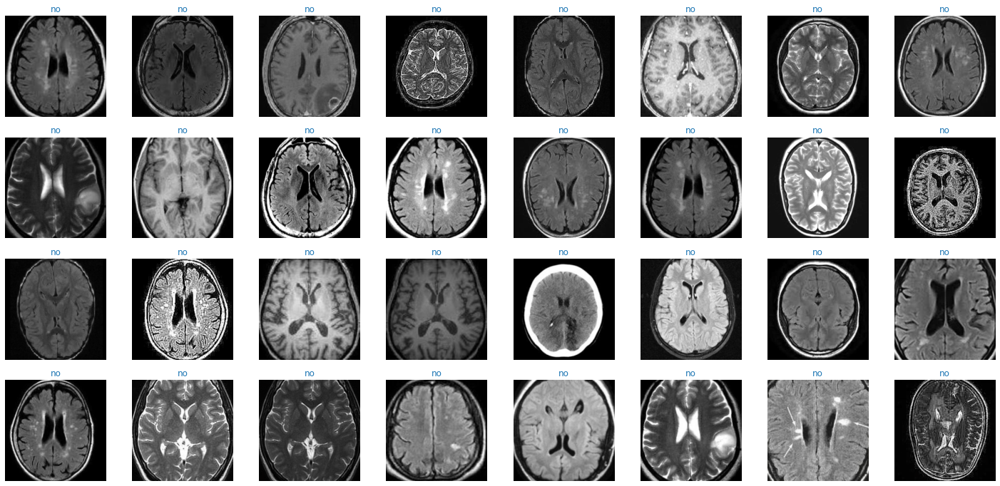

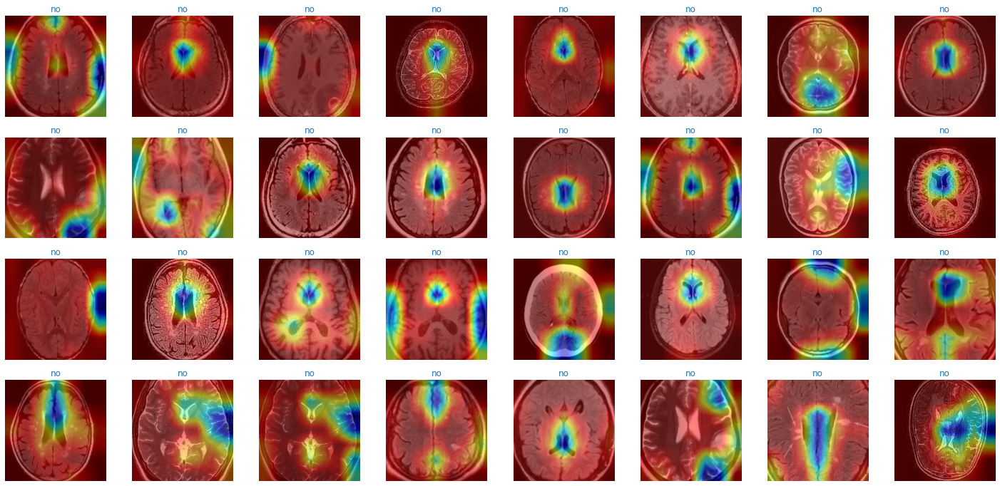

In [46]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

<div dir="rtl">
   با توجه به اینکه داده های تست تعداد کمتری نسبت به داده های آموزشی دارند برای همین ممکن است هنگام استفاده از Gradcam داده ای با لیبل no صرفا انتخاب شوند همانطور که در بالا مشاهده می کنید به همین علت برای دید بهتر و درک بهتر نتایج Gard Cam از یکبار هم از مجموعه دادگان آموزشی استفاده می کنیم که تا احتمال حضور دادگان با لیبل yes نیز افزایش یابد و بتوانیم نتایج را بهتر مشاهده کنیم 
</dir>

In [47]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(train_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


C:\Users\asus\anaconda3\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


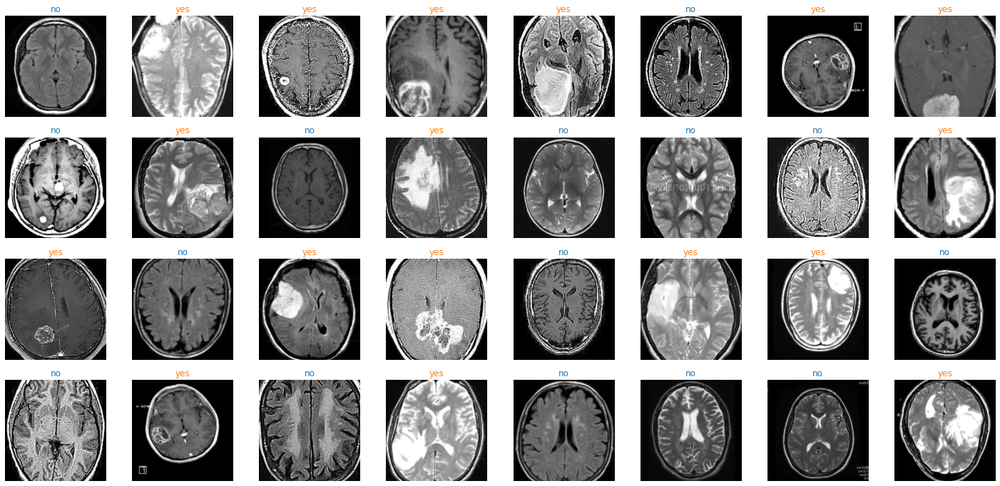

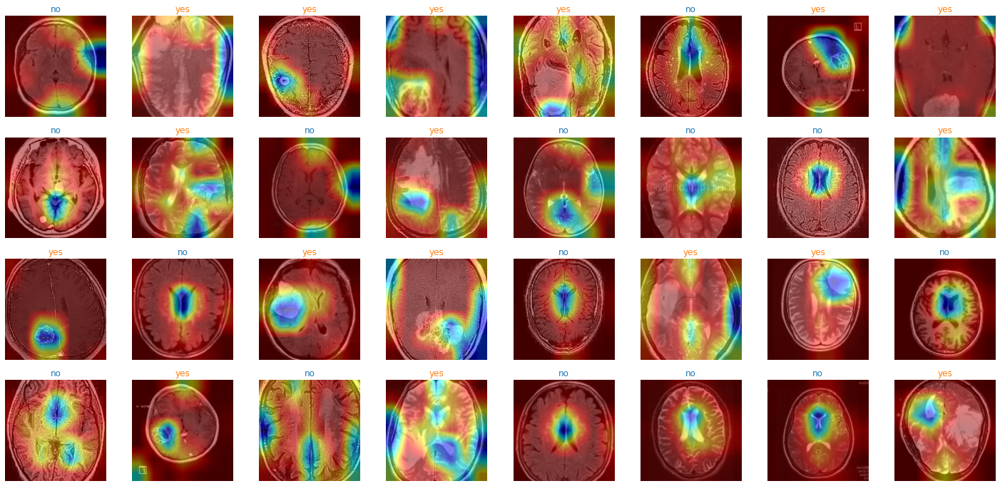

In [48]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

In [49]:
########################## P12 #########################
# Change the Learning Rate and compare the results.    #
# write your observation and its reasons in the next   #
# cell.                                                #
########################################################
optimizer = torch.optim.Adam(vgg16_imagenet.parameters(), lr=1e-2)
########################## END #########################

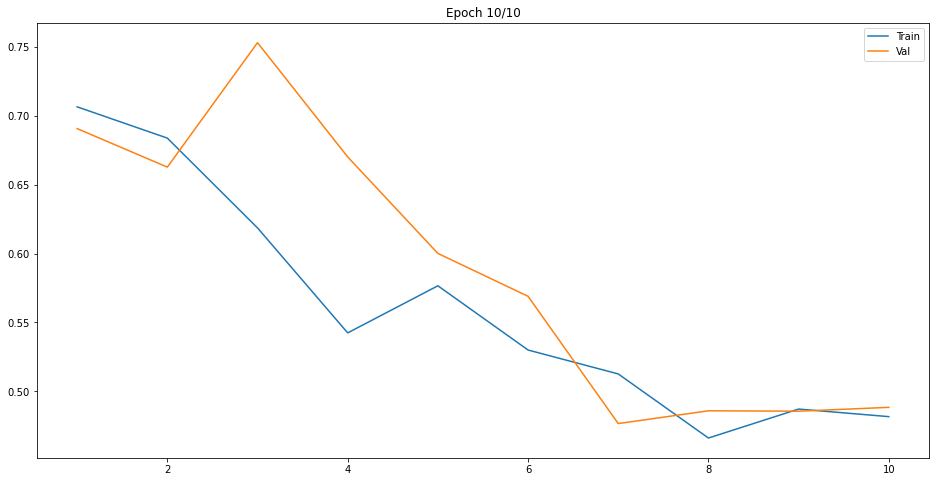

In [50]:
train(vgg16_imagenet, train_loader, val_loader, optimizer, num_epochs=10)

In [51]:
test(vgg16_imagenet, train_loader)

              precision    recall  f1-score   support

          no       0.92      0.70      0.79      1041
         yes       0.76      0.94      0.84      1059

    accuracy                           0.82      2100
   macro avg       0.84      0.82      0.82      2100
weighted avg       0.84      0.82      0.82      2100



In [52]:
test(vgg16_imagenet, val_loader)

C:\Users\asus\anaconda3\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.89      0.61      0.72       307
         yes       0.69      0.92      0.79       293

    accuracy                           0.76       600
   macro avg       0.79      0.77      0.76       600
weighted avg       0.80      0.76      0.76       600



In [53]:
test(vgg16_imagenet, test_loader)

C:\Users\asus\anaconda3\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.95      0.70      0.81       152
         yes       0.76      0.97      0.85       148

    accuracy                           0.83       300
   macro avg       0.86      0.83      0.83       300
weighted avg       0.86      0.83      0.83       300



In [54]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(test_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


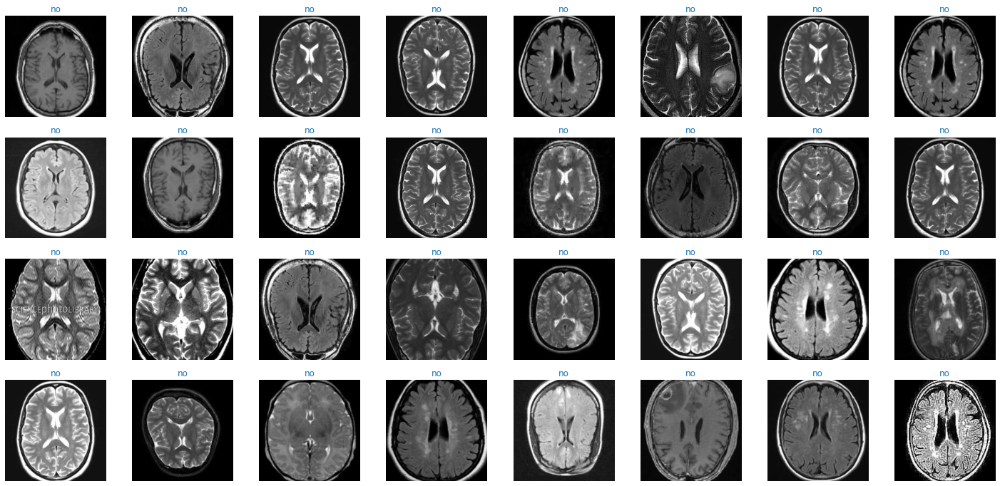

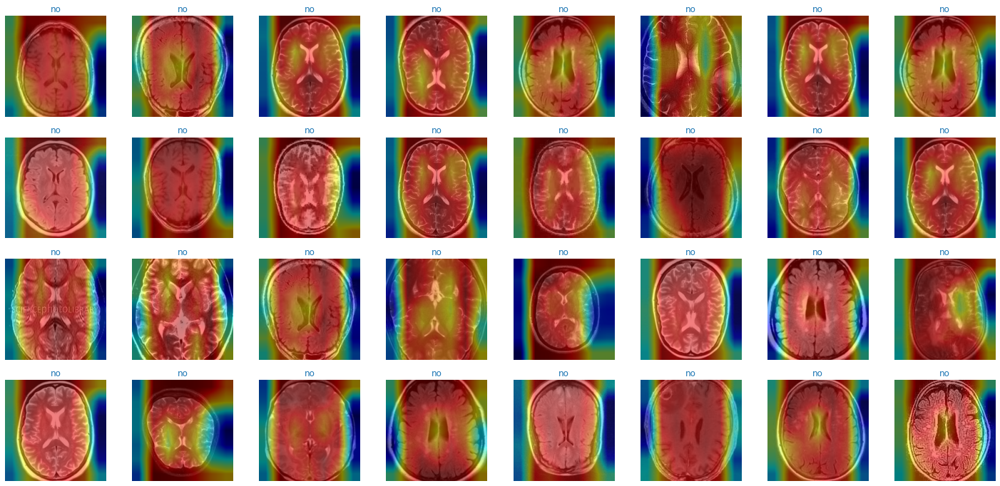

In [55]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

<div dir="rtl">
   با توجه به اینکه داده های تست تعداد کمتری نسبت به داده های آموزشی دارند برای همین ممکن است هنگام استفاده از Gradcam داده ای با لیبل no صرفا انتخاب شوند همانطور که در بالا مشاهده می کنید به همین علت برای دید بهتر و درک بهتر نتایج Gard Cam از یکبار هم از مجموعه دادگان آموزشی استفاده می کنیم که تا احتمال حضور دادگان با لیبل yes نیز افزایش یابد و بتوانیم نتایج را بهتر مشاهده کنیم 
</dir>

In [56]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(train_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


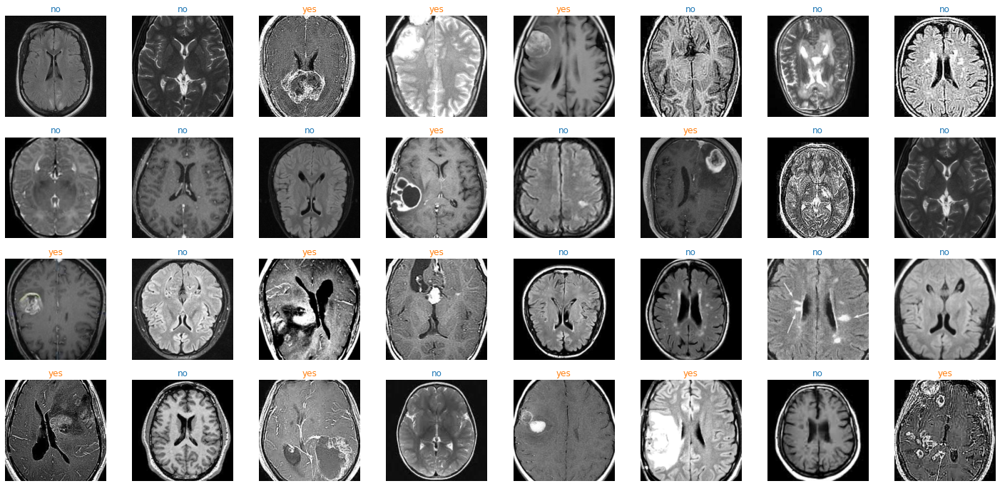

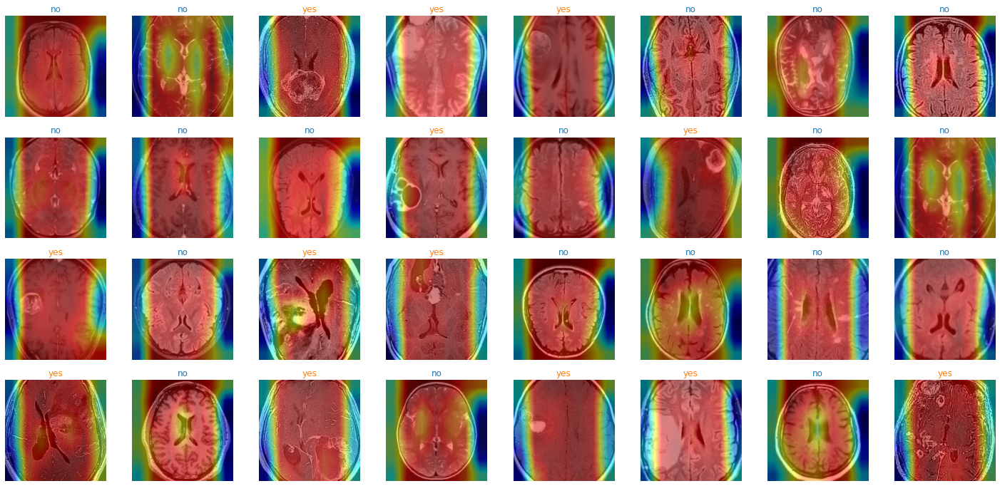

In [57]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

In [19]:
########################## P12 #########################
# Change the Learning Rate and compare the results.    #
# write your observation and its reasons in the next   #
# cell.                                                #
########################################################
optimizer = torch.optim.Adam(vgg16_imagenet.parameters(), lr=1e-4)
########################## END #########################

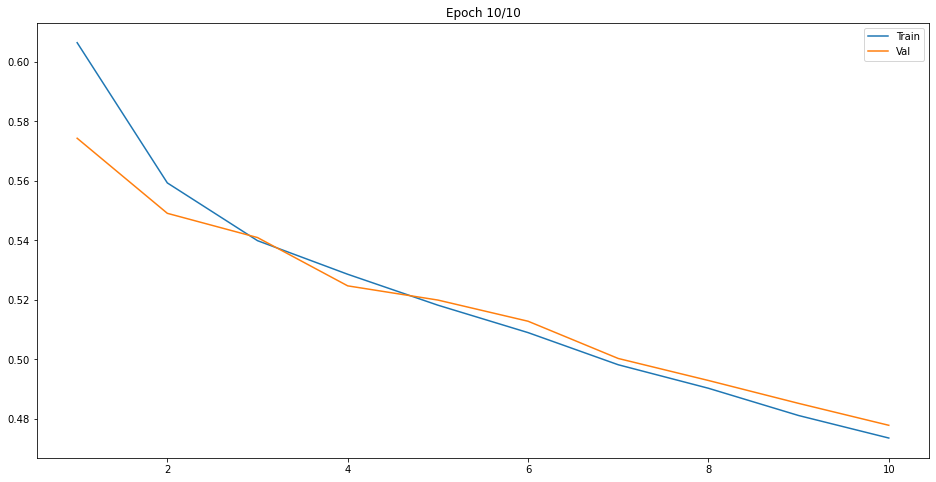

In [20]:
train(vgg16_imagenet, train_loader, val_loader, optimizer, num_epochs=10)

In [21]:
test(vgg16_imagenet, train_loader)

              precision    recall  f1-score   support

          no       1.00      1.00      1.00      1067
         yes       1.00      1.00      1.00      1033

    accuracy                           1.00      2100
   macro avg       1.00      1.00      1.00      2100
weighted avg       1.00      1.00      1.00      2100



In [22]:
test(vgg16_imagenet, val_loader)

C:\Users\asus\anaconda3\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.99      1.00      0.99       286
         yes       1.00      0.99      1.00       314

    accuracy                           0.99       600
   macro avg       0.99      1.00      0.99       600
weighted avg       1.00      0.99      1.00       600



In [23]:
test(vgg16_imagenet, test_loader)

C:\Users\asus\anaconda3\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.99      0.99      0.99       147
         yes       0.99      0.99      0.99       153

    accuracy                           0.99       300
   macro avg       0.99      0.99      0.99       300
weighted avg       0.99      0.99      0.99       300



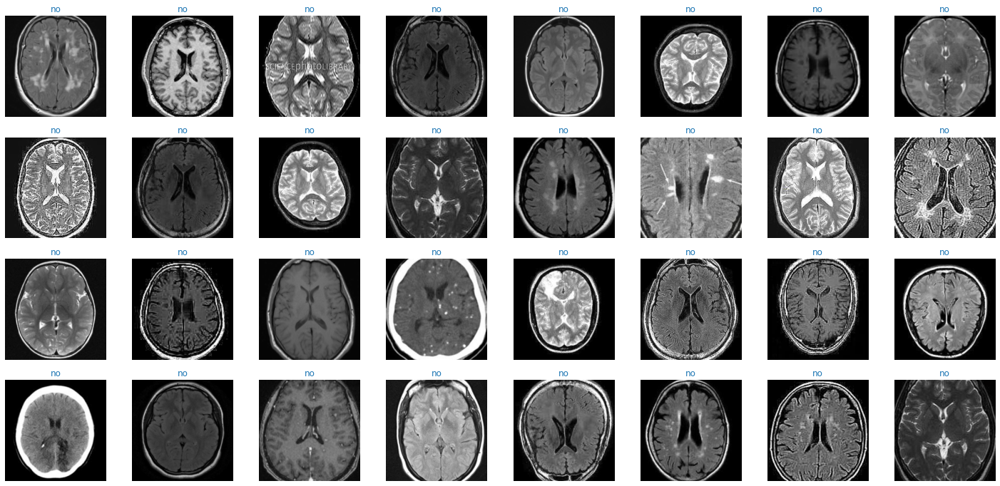

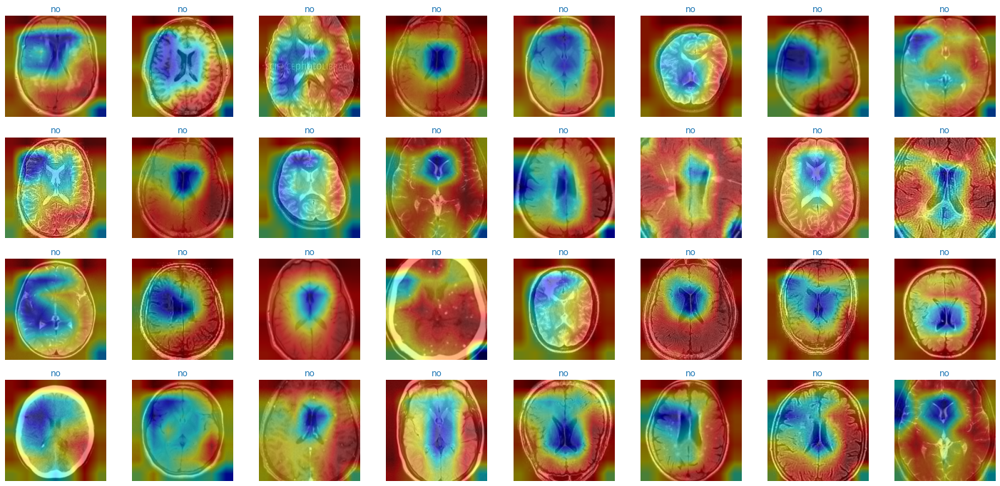

In [29]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

<div dir="rtl">
   با توجه به اینکه داده های تست تعداد کمتری نسبت به داده های آموزشی دارند برای همین ممکن است هنگام استفاده از Gradcam داده ای با لیبل no صرفا انتخاب شوند همانطور که در بالا مشاهده می کنید به همین علت برای دید بهتر و درک بهتر نتایج Gard Cam از یکبار هم از مجموعه دادگان آموزشی استفاده می کنیم که تا احتمال حضور دادگان با لیبل yes نیز افزایش یابد و بتوانیم نتایج را بهتر مشاهده کنیم 
</dir>

In [32]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(train_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


C:\Users\asus\anaconda3\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


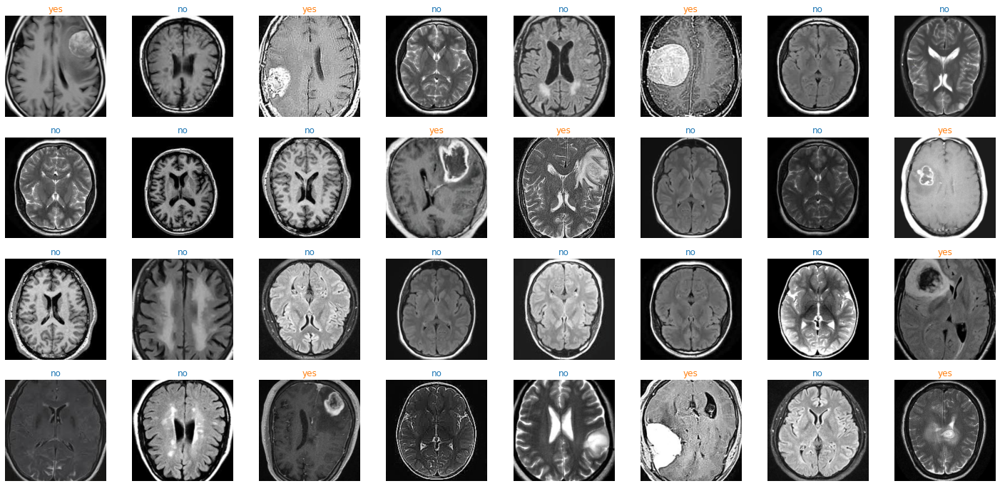

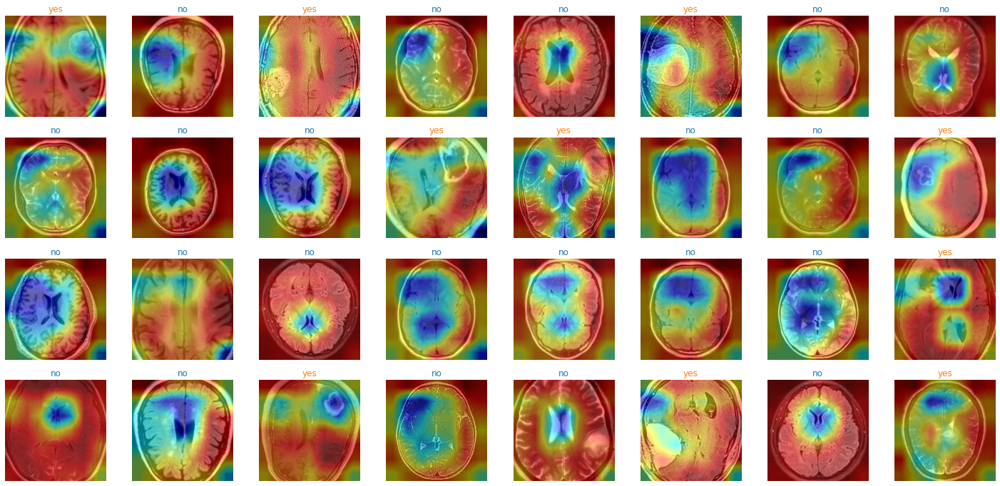

In [33]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

# Questions
Answer the following questions:

## P13:
<div dir="rtl">
دلایلی که باعث بهبود نتیجه با استفاده از Transfer Learning شده‌اند، چیست؟
</dir>

<div dir="rtl">
جواب را اینجا بنویسید
</div>

In [25]:
vgg16_pretrained = torchvision.models.vgg16_bn() 

In [27]:
vgg16_pretrained

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256